In [38]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns 
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
%matplotlib inline 

In [2]:
df = pd.read_csv('/Users/aneruthmohanasundaram/Documents/GitHub/Machine_Learning/Datasets/USA_Housing.csv')
df.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\nLaurabury, NE 3701..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\nLake Kathleen, CA..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\nDanieltown, WI 06482..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\nFPO AE 09386


In [3]:
df.describe()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5.000000e+03
mean,68583.108984,5.977222,6.987792,3.981330,36163.516039,1.232073e+06
std,10657.991214,0.991456,1.005833,1.234137,9925.650114,3.531176e+05
min,17796.631190,2.644304,3.236194,2.000000,172.610686,1.593866e+04
25%,61480.562388,5.322283,6.299250,3.140000,29403.928702,9.975771e+05
50%,68804.286404,5.970429,7.002902,4.050000,36199.406689,1.232669e+06
75%,75783.338666,6.650808,7.665871,4.490000,42861.290769,1.471210e+06
max,107701.748378,9.519088,10.759588,6.500000,69621.713378,2.469066e+06


&lt;seaborn.axisgrid.PairGrid at 0x7fe5236061f0&gt;

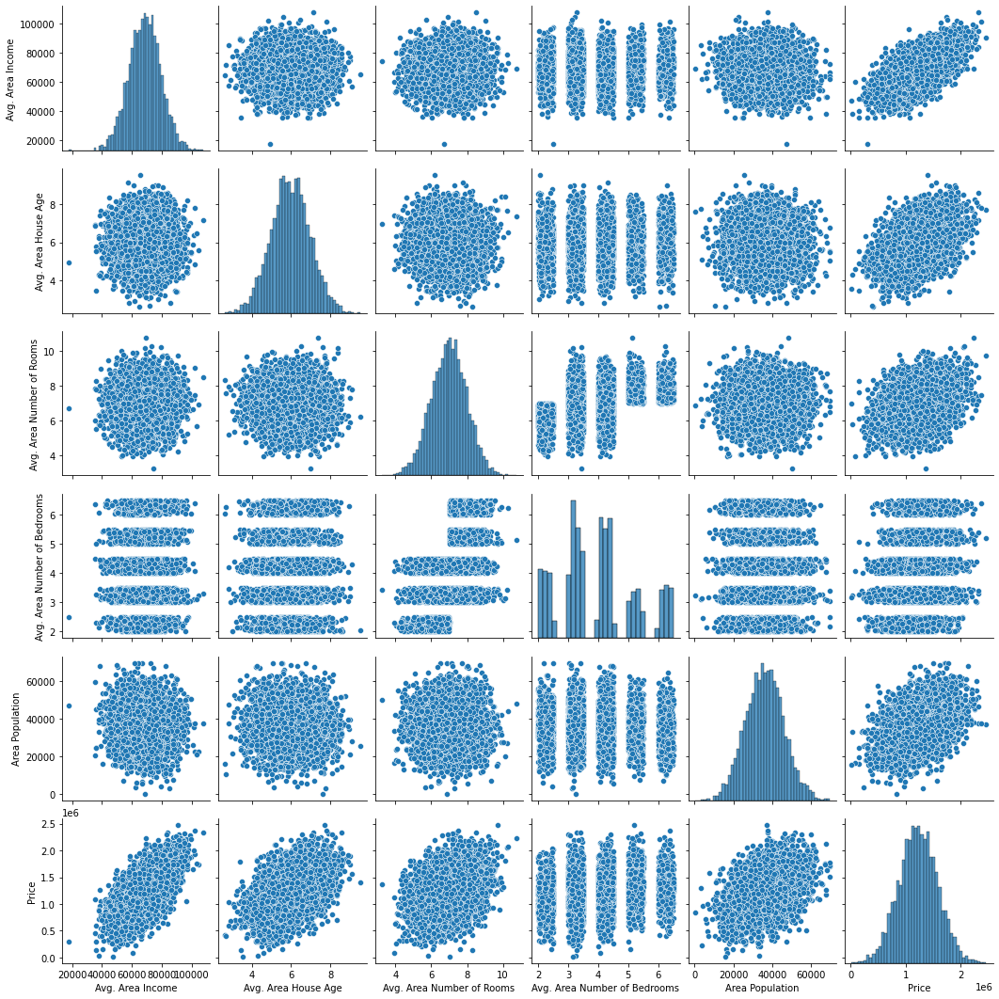

In [4]:
# To plot a simple plot 
sns.pairplot(df)

&lt;AxesSubplot:xlabel=&#39;Price&#39;, ylabel=&#39;Count&#39;&gt;

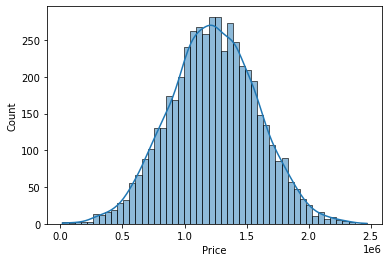

In [5]:
# Distribution of one column 
sns.histplot(df['Price'],kde=True,bins=50)

&lt;AxesSubplot:&gt;

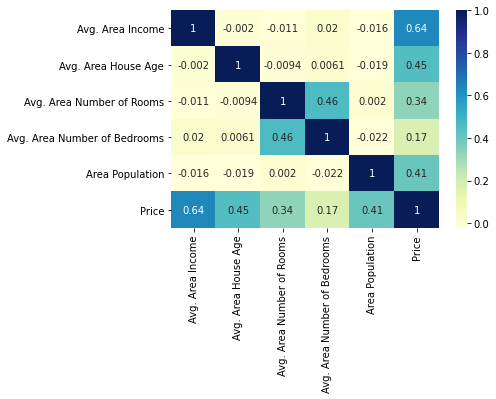

In [8]:
# To find the correlation for each of the columns 
sns.heatmap(df.corr(),cmap="YlGnBu",annot=True)

In [11]:
df.columns

Index([&#39;Avg. Area Income&#39;, &#39;Avg. Area House Age&#39;, &#39;Avg. Area Number of Rooms&#39;,
       &#39;Avg. Area Number of Bedrooms&#39;, &#39;Area Population&#39;, &#39;Price&#39;, &#39;Address&#39;],
      dtype=&#39;object&#39;)

In [16]:
# To create a feature and target variable 
X = df[['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population']]

y= df['Price']

In [23]:
# Basically we do here is a tuple unpacking where we assign the test and train data for our assigned variable 

# the test_size is the percentage of the data we need to allocate

# random_state is to splits a specific set of random data because the train_test_split occurs randomly 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=101)

In [24]:
# Initalise the linear regression model 
lm = LinearRegression()

In [30]:
# To fit my model to the training data.
a = lm.fit(X_train,y_train)
print(a)

# To Print the intercept.
print("The intercept is:",lm.intercept_)

# to print the coefficeint 
print("The coeffcient is:",lm.coef_)

LinearRegression()
The intercept is: -2640159.796853739
The coeffcient is: [2.15282755e+01 1.64883282e+05 1.22368678e+05 2.23380186e+03
 1.51504200e+01]


In [31]:
# Create a new DataFrame with respect to the X_train Columns 
col = pd.DataFrame(lm.coef_,X.columns,columns=['Coefficient'])
col
# It's bascially like if a unit increases in any columns such as Area Income will increase by 21.52.
# Rest is simmilar to the first one. 

,Coefficient
Avg. Area Income,21.528276
Avg. Area House Age,164883.282027
Avg. Area Number of Rooms,122368.678027
Avg. Area Number of Bedrooms,2233.801864
Area Population,15.150420


In [32]:
######################################################### Predicting our model ############################################################

&lt;matplotlib.collections.PathCollection at 0x7fe50e1b0dc0&gt;

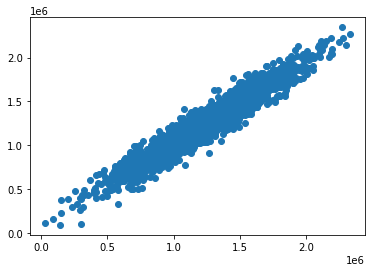

In [33]:
pre = lm.predict(X_test)

# To compare the predictions with the actual y_test value. 
plt.scatter(y_test,pre)

&lt;AxesSubplot:xlabel=&#39;Price&#39;, ylabel=&#39;Count&#39;&gt;

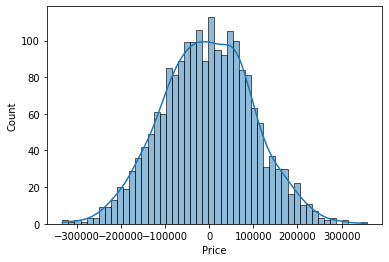

In [35]:
# To analyse our residual distribution 
sns.histplot((y_test-pre),kde=True,bins=50) 

In [39]:
# Regression Evaluation Matrices 

# To print the Mean Absolute Error Method 
print("MAE of our dataset is:",metrics.mean_absolute_error(y_test,pre))

# To print the Mean Square Error Method 
print("MSE of our dataset is:",metrics.mean_squared_error(y_test,pre))

# To print the Root Mean Square Error Method
print('RMSE of our dataset is:',np.sqrt(metrics.mean_squared_error(y_test,pre)))

MAE of our dataset is: 82288.22251914928
MSE of our dataset is: 10460958907.208244
RMSE of our dataset is: 102278.82922290538
